In [2]:
import matplotlib.pyplot as plt
import numpy as np
import glob
import cv2
import gc
import pickle
import tensorflow
import pandas as pd
from tensorflow import keras
from skimage.color import rgb2gray
from skimage.measure import label 
from scipy.ndimage import binary_opening, binary_closing, rotate
from scipy.ndimage.morphology import binary_fill_holes
from sklearn.model_selection import train_test_split

In [3]:
X_train = pickle.load(open('x_train.pkl', 'rb'))
y_train = pickle.load(open('y_train.pkl', 'rb'))
X_test = pickle.load(open('x_test.pkl', 'rb'))
y_test = pickle.load(open('y_test.pkl', 'rb'))

In [4]:
from keras.utils import np_utils

# One-hot encode the training labels
y_train_OH = np_utils.to_categorical(y_train)

# One-hot encode the test labels
y_test_OH = np_utils.to_categorical(y_test)

In [5]:
X_train_reshaped = np.array(X_train).reshape(8880, 225, 225, 1)
X_test_reshaped = np.array(X_test).reshape(2195, 225, 225, 1)

In [6]:
from sklearn.utils import shuffle
x, y = shuffle(X_train_reshaped, y_train_OH, random_state=99)

In [7]:
tensorflow.config.run_functions_eagerly(True)

In [9]:
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.layers import Flatten, Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier


def build_model():
    
    model = Sequential()
    model.add(Conv2D(filters=5, kernel_size=5, padding='same', activation='relu', 
                        input_shape=(225, 225, 1)))
    model.add(MaxPooling2D(4,4))
    model.add(Conv2D(filters=15, kernel_size=5, padding='same', activation='relu'))
    model.add(MaxPooling2D(4,4))
    model.add(Conv2D(filters=35, kernel_size=5, padding='same', activation='relu'))
    model.add(MaxPooling2D(4,4))
    model.add(Flatten())
    model.add(Dense(3, activation='softmax'))
    
    # Compile the model
    model.compile(optimizer='rmsprop',
              loss='categorical_crossentropy',
              metrics=['accuracy'])
    print(model.summary())
    return model

estimator = KerasClassifier(build_fn= build_model, epochs = 30)

In [15]:
# Train the model
hist = estimator.fit(x, y, validation_split=0.2, batch_size=128)

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_30 (Conv2D)           (None, 225, 225, 5)       130       
_________________________________________________________________
max_pooling2d_30 (MaxPooling (None, 56, 56, 5)         0         
_________________________________________________________________
conv2d_31 (Conv2D)           (None, 56, 56, 15)        1890      
_________________________________________________________________
max_pooling2d_31 (MaxPooling (None, 14, 14, 15)        0         
_________________________________________________________________
conv2d_32 (Conv2D)           (None, 14, 14, 35)        13160     
_________________________________________________________________
max_pooling2d_32 (MaxPooling (None, 3, 3, 35)          0         
_________________________________________________________________
flatten_10 (Flatten)         (None, 315)             

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


Epoch 1/30
56/56 [==============================] - 6s 105ms/step - loss: 1.0172 - accuracy: 0.4817 - val_loss: 0.9179 - val_accuracy: 0.5580
Epoch 2/30
56/56 [==============================] - 5s 93ms/step - loss: 0.8621 - accuracy: 0.6028 - val_loss: 0.8154 - val_accuracy: 0.6334
Epoch 3/30
56/56 [==============================] - 5s 95ms/step - loss: 0.7981 - accuracy: 0.6374 - val_loss: 0.7511 - val_accuracy: 0.6599
Epoch 4/30
56/56 [==============================] - 5s 95ms/step - loss: 0.7467 - accuracy: 0.6650 - val_loss: 0.7303 - val_accuracy: 0.6419
Epoch 5/30
56/56 [==============================] - 6s 99ms/step - loss: 0.6965 - accuracy: 0.6990 - val_loss: 0.7276 - val_accuracy: 0.6858
Epoch 6/30
56/56 [==============================] - 6s 109ms/step - loss: 0.6605 - accuracy: 0.7159 - val_loss: 0.6989 - val_accuracy: 0.6723
Epoch 7/30
56/56 [==============================] - 6s 112ms/step - loss: 0.6315 - accuracy: 0.7347 - val_loss: 0.6709 - val_accuracy: 0.6886
Epoch 8/30

In [10]:
# Cross-validation
from sklearn.model_selection import cross_val_score
accuracies = cross_val_score(estimator = estimator, X = x, y = y, cv = 10)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 225, 225, 5)       130       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 56, 56, 5)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 56, 56, 15)        1890      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 14, 14, 15)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 14, 14, 35)        13160     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 3, 3, 35)          0         
_________________________________________________________________
flatten (Flatten)            (None, 315)               0

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


Epoch 1/30
250/250 [==============================] - 16s 38ms/step - loss: 0.9182 - accuracy: 0.5342
Epoch 2/30
250/250 [==============================] - 9s 38ms/step - loss: 0.7154 - accuracy: 0.6782
Epoch 3/30
250/250 [==============================] - 9s 36ms/step - loss: 0.6223 - accuracy: 0.7299
Epoch 4/30
250/250 [==============================] - 9s 35ms/step - loss: 0.5653 - accuracy: 0.7669
Epoch 5/30
250/250 [==============================] - 9s 36ms/step - loss: 0.5237 - accuracy: 0.7887
Epoch 6/30
250/250 [==============================] - 8s 32ms/step - loss: 0.4899 - accuracy: 0.8021
Epoch 7/30
250/250 [==============================] - 8s 32ms/step - loss: 0.4523 - accuracy: 0.8241
Epoch 8/30
250/250 [==============================] - 8s 33ms/step - loss: 0.4225 - accuracy: 0.8327
Epoch 9/30
250/250 [==============================] - 9s 34ms/step - loss: 0.3884 - accuracy: 0.8486
Epoch 10/30
250/250 [==============================] - 8s 33ms/step - loss: 0.3613 - accur

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


250/250 [==============================] - 11s 45ms/step - loss: 0.9043 - accuracy: 0.5613
Epoch 2/30
250/250 [==============================] - 10s 39ms/step - loss: 0.7123 - accuracy: 0.6826
Epoch 3/30
250/250 [==============================] - 14s 55ms/step - loss: 0.6372 - accuracy: 0.7250
Epoch 4/30
250/250 [==============================] - 13s 51ms/step - loss: 0.5937 - accuracy: 0.7440
Epoch 5/30
250/250 [==============================] - 13s 50ms/step - loss: 0.5611 - accuracy: 0.7629
Epoch 6/30
250/250 [==============================] - 13s 52ms/step - loss: 0.5306 - accuracy: 0.7779
Epoch 7/30
250/250 [==============================] - 12s 49ms/step - loss: 0.5038 - accuracy: 0.7937
Epoch 8/30
250/250 [==============================] - 12s 47ms/step - loss: 0.4781 - accuracy: 0.8091
Epoch 9/30
250/250 [==============================] - 12s 47ms/step - loss: 0.4475 - accuracy: 0.82170s - loss: 0.4475 - accuracy: 0.82
Epoch 10/30
250/250 [==============================] - 15s 

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


Epoch 1/30
250/250 [==============================] - 16s 65ms/step - loss: 0.9028 - accuracy: 0.5579
Epoch 2/30
250/250 [==============================] - 15s 60ms/step - loss: 0.7025 - accuracy: 0.6933
Epoch 3/30
250/250 [==============================] - 15s 60ms/step - loss: 0.6215 - accuracy: 0.7331
Epoch 4/30
250/250 [==============================] - 15s 58ms/step - loss: 0.5738 - accuracy: 0.7563
Epoch 5/30
250/250 [==============================] - 14s 56ms/step - loss: 0.5304 - accuracy: 0.7822
Epoch 6/30
250/250 [==============================] - 13s 54ms/step - loss: 0.4940 - accuracy: 0.8002
Epoch 7/30
250/250 [==============================] - 19s 76ms/step - loss: 0.4551 - accuracy: 0.8132
Epoch 8/30
250/250 [==============================] - 17s 67ms/step - loss: 0.4219 - accuracy: 0.8330
Epoch 9/30
250/250 [==============================] - 15s 61ms/step - loss: 0.3946 - accuracy: 0.8436
Epoch 10/30
250/250 [==============================] - 13s 52ms/step - loss: 0.363

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


250/250 [==============================] - 14s 57ms/step - loss: 0.9093 - accuracy: 0.5458
Epoch 2/30
250/250 [==============================] - 16s 65ms/step - loss: 0.7146 - accuracy: 0.6768
Epoch 3/30
250/250 [==============================] - 16s 65ms/step - loss: 0.6440 - accuracy: 0.7126
Epoch 4/30
250/250 [==============================] - 15s 60ms/step - loss: 0.5863 - accuracy: 0.7489
Epoch 5/30
250/250 [==============================] - 16s 62ms/step - loss: 0.5477 - accuracy: 0.7693
Epoch 6/30
250/250 [==============================] - 15s 59ms/step - loss: 0.5169 - accuracy: 0.7837
Epoch 7/30
250/250 [==============================] - 18s 73ms/step - loss: 0.4905 - accuracy: 0.8011
Epoch 8/30
250/250 [==============================] - 14s 57ms/step - loss: 0.4605 - accuracy: 0.8117
Epoch 9/30
250/250 [==============================] - 16s 62ms/step - loss: 0.4367 - accuracy: 0.8257
Epoch 10/30
250/250 [==============================] - 17s 66ms/step - loss: 0.4160 - accurac

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


250/250 [==============================] - 19s 75ms/step - loss: 0.9005 - accuracy: 0.5651
Epoch 2/30
250/250 [==============================] - 21s 85ms/step - loss: 0.7068 - accuracy: 0.6896
Epoch 3/30
250/250 [==============================] - 20s 79ms/step - loss: 0.6277 - accuracy: 0.7342
Epoch 4/30
250/250 [==============================] - 26s 104ms/step - loss: 0.5722 - accuracy: 0.7620
Epoch 5/30
250/250 [==============================] - 22s 90ms/step - loss: 0.5286 - accuracy: 0.7867
Epoch 6/30
250/250 [==============================] - 24s 95ms/step - loss: 0.4924 - accuracy: 0.7974
Epoch 7/30
250/250 [==============================] - 18s 71ms/step - loss: 0.4624 - accuracy: 0.8144
Epoch 8/30
250/250 [==============================] - 21s 83ms/step - loss: 0.4283 - accuracy: 0.8292
Epoch 9/30
250/250 [==============================] - 23s 94ms/step - loss: 0.4043 - accuracy: 0.8435
Epoch 10/30
250/250 [==============================] - 21s 84ms/step - loss: 0.3726 - accura

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


250/250 [==============================] - 23s 93ms/step - loss: 0.9173 - accuracy: 0.5578
Epoch 2/30
250/250 [==============================] - 26s 104ms/step - loss: 0.7156 - accuracy: 0.6834
Epoch 3/30
250/250 [==============================] - 21s 85ms/step - loss: 0.6187 - accuracy: 0.7427
Epoch 4/30
250/250 [==============================] - 24s 96ms/step - loss: 0.5590 - accuracy: 0.7690
Epoch 5/30
250/250 [==============================] - 23s 91ms/step - loss: 0.5125 - accuracy: 0.7885
Epoch 6/30
250/250 [==============================] - 32s 130ms/step - loss: 0.4786 - accuracy: 0.8139
Epoch 7/30
250/250 [==============================] - 24s 94ms/step - loss: 0.4442 - accuracy: 0.8247
Epoch 8/30
250/250 [==============================] - 22s 88ms/step - loss: 0.4023 - accuracy: 0.8435
Epoch 9/30
250/250 [==============================] - 26s 104ms/step - loss: 0.3848 - accuracy: 0.8536
Epoch 10/30
250/250 [==============================] - 26s 104ms/step - loss: 0.3590 - acc

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


Epoch 1/30
250/250 [==============================] - 11s 43ms/step - loss: 0.8938 - accuracy: 0.5617
Epoch 2/30
250/250 [==============================] - 20s 81ms/step - loss: 0.7033 - accuracy: 0.6894
Epoch 3/30
250/250 [==============================] - 19s 76ms/step - loss: 0.6256 - accuracy: 0.7315
Epoch 4/30
250/250 [==============================] - 19s 77ms/step - loss: 0.5767 - accuracy: 0.7525
Epoch 5/30
250/250 [==============================] - 19s 75ms/step - loss: 0.5376 - accuracy: 0.7794
Epoch 6/30
250/250 [==============================] - 19s 76ms/step - loss: 0.4987 - accuracy: 0.7962
Epoch 7/30
250/250 [==============================] - 21s 83ms/step - loss: 0.4689 - accuracy: 0.8078
Epoch 8/30
250/250 [==============================] - 20s 80ms/step - loss: 0.4355 - accuracy: 0.8228
Epoch 9/30
250/250 [==============================] - 14s 56ms/step - loss: 0.4067 - accuracy: 0.8390
Epoch 10/30
250/250 [==============================] - 20s 79ms/step - loss: 0.387

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


250/250 [==============================] - 14s 57ms/step - loss: 0.9087 - accuracy: 0.55931s - loss: 0.9
Epoch 2/30
250/250 [==============================] - 16s 64ms/step - loss: 0.7050 - accuracy: 0.6882
Epoch 3/30
250/250 [==============================] - 17s 66ms/step - loss: 0.6293 - accuracy: 0.7340
Epoch 4/30
250/250 [==============================] - 18s 71ms/step - loss: 0.5780 - accuracy: 0.7565
Epoch 5/30
250/250 [==============================] - 17s 69ms/step - loss: 0.5410 - accuracy: 0.7822
Epoch 6/30
250/250 [==============================] - 19s 76ms/step - loss: 0.5020 - accuracy: 0.7953
Epoch 7/30
250/250 [==============================] - 14s 57ms/step - loss: 0.4681 - accuracy: 0.8141
Epoch 8/30
250/250 [==============================] - 19s 77ms/step - loss: 0.4396 - accuracy: 0.8238
Epoch 9/30
250/250 [==============================] - 17s 68ms/step - loss: 0.4122 - accuracy: 0.8381
Epoch 10/30
250/250 [==============================] - 14s 58ms/step - loss: 0.

C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\data\ops\dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(


250/250 [==============================] - 16s 62ms/step - loss: 0.8805 - accuracy: 0.5857
Epoch 2/30
250/250 [==============================] - 17s 69ms/step - loss: 0.6997 - accuracy: 0.6903
Epoch 3/30
250/250 [==============================] - 23s 90ms/step - loss: 0.6126 - accuracy: 0.7399
Epoch 4/30
250/250 [==============================] - 18s 73ms/step - loss: 0.5675 - accuracy: 0.7645
Epoch 5/30
250/250 [==============================] - 16s 63ms/step - loss: 0.5346 - accuracy: 0.7798
Epoch 6/30
250/250 [==============================] - 15s 62ms/step - loss: 0.5047 - accuracy: 0.7932
Epoch 7/30
250/250 [==============================] - 17s 66ms/step - loss: 0.4755 - accuracy: 0.8067
Epoch 8/30
250/250 [==============================] - 18s 71ms/step - loss: 0.4541 - accuracy: 0.8197
Epoch 9/30
250/250 [==============================] - 18s 72ms/step - loss: 0.4203 - accuracy: 0.8341
Epoch 10/30
250/250 [==============================] - 16s 64ms/step - loss: 0.4031 - accurac

C:\Users\canki\anaconda3\envs\tensor_gpu\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
1 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\canki\anaconda3\envs\tensor_gpu\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\python\keras\wrappers\scikit_learn.py", line 220, in fit
    return super(KerasClassifier, self).fit(x, y, **kwargs)
  File "C:\Users\canki\AppData\Roaming\Python\Python38\site-packages\tensorflow\pyt

In [11]:
accuracies

array([0.86936939, 0.875     , 0.8231982 , 0.8367117 , 0.82207209,
       0.8277027 , 0.83333331, 0.82882881, 0.78603601,        nan])

In [13]:
accuracies[0:9].mean()

0.8335835801230537

In [16]:
score = estimator.model.evaluate(x=X_test_reshaped, 
                       y=y_test_OH,
                       verbose=0)
print('Test accuracy:', score[1])

Test accuracy: 0.8013667464256287


In [17]:
# Get predicted probabilities for test dataset
y_probs = estimator.model.predict(X_test_reshaped)

In [18]:
# Get predicted labels for test dataset
y_preds = np.argmax(y_probs, axis=1)

In [19]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_preds))

              precision    recall  f1-score   support

           0       0.87      0.88      0.87      1447
           1       0.59      0.49      0.53       367
           2       0.73      0.82      0.78       381

    accuracy                           0.80      2195
   macro avg       0.73      0.73      0.73      2195
weighted avg       0.80      0.80      0.80      2195



In [28]:
# Indices corresponding to test images which were mislabeled
bad_test_idxs = np.where(y_test!=y_preds)

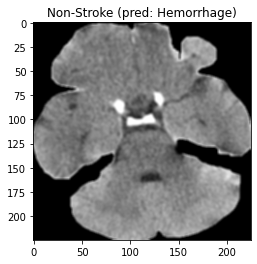

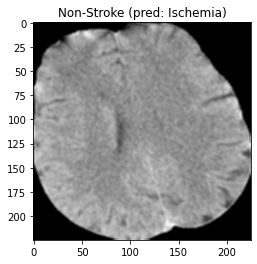

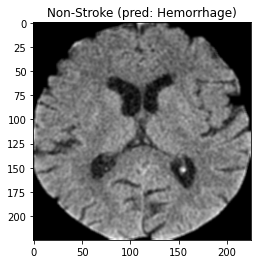

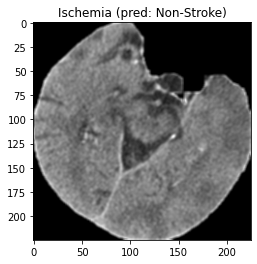

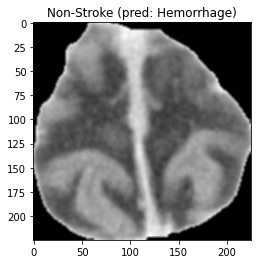

...

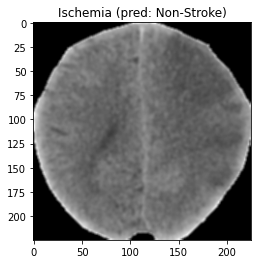

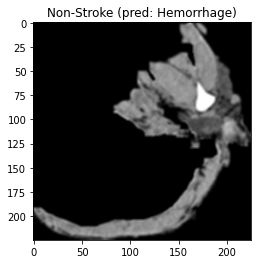

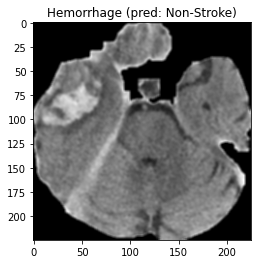

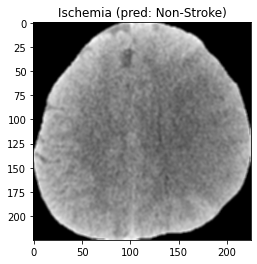

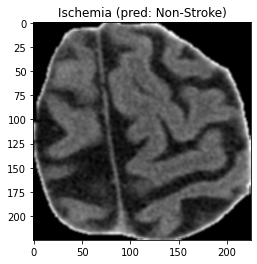

In [31]:
# Print mislabeled examples
for i in bad_test_idxs[0]:
    plt.imshow(X_test[i], cmap='gray')
    plt.title("{} (pred: {})".format(label[y_test[i]], label[y_preds[i]]))
    plt.show()

<Figure size 576x432 with 0 Axes>

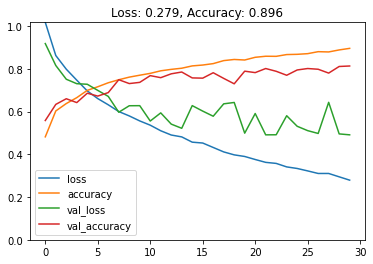

In [25]:
plot_loss_accuracy(hist)